# Outliers Electricity demand 2001-2025

### changing settlement_date to match one format 

Read Dataset 2 Cleaned

In [1]:
# Dataset 2: electricity_demand_2001_2025_NA
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Load the data
energy = pd.read_csv("../../Dataset1/Cleaned/electricity_demand_2001_2025_NA.csv")
print(energy.head())

  settlement_date  settlement_period     nd  tsd  england_wales_demand  \
0      2001-01-01                  1  38631  NaN                 34060   
1      2001-01-01                  2  39808  NaN                 35370   
2      2001-01-01                  3  40039  NaN                 35680   
3      2001-01-01                  4  39339  NaN                 35029   
4      2001-01-01                  5  38295  NaN                 34047   

   embedded_wind_generation  embedded_wind_capacity  \
0                       NaN                     NaN   
1                       NaN                     NaN   
2                       NaN                     NaN   
3                       NaN                     NaN   
4                       NaN                     NaN   

   embedded_solar_generation  embedded_solar_capacity  non_bm_stor  ...  \
0                        NaN                      NaN            0  ...   
1                        NaN                      NaN            0  ...   

Convert all dates to 'YYYY-MM-DD'

In [2]:
#Rename columns
energy.columns = energy.columns.str.replace(' ', '_')

# Function to handle all 3 date formats
def parse_dates(date):
    for fmt in ("%Y-%m-%d", "%d-%b-%Y", "%d-%b-%y"):
        try:
            return pd.to_datetime(date, format=fmt)
        except:
            continue
    # If none works, return NaT
    return pd.NaT

# Apply the function
energy['settlement_date'] = energy['settlement_date'].apply(parse_dates)
# Convert all dates to 'YYYY-MM-DD' string format
energy['settlement_date'] = energy['settlement_date'].dt.strftime('%Y-%m-%d')


# Drop columns 'nd' and 'tsd' since they have no values
energy = energy.drop(columns=['nd', 'tsd'])
print('Dropped columns: nd, tsd')

Dropped columns: nd, tsd


In [ ]:
# Save the cleaned DataFrame with standardized date format to a CSV
energy.to_csv('../../Dataset1/Cleaned/electricity_demand_2001_2025_cleaned.csv', index=False)

## Outliers

In [4]:
# IQR method for full dataset

Q1 = energy['england_wales_demand'].quantile(0.25)
Q3 = energy['england_wales_demand'].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

outliers = energy[(energy['england_wales_demand'] < lower_bound) | (energy['england_wales_demand'] > upper_bound)]
print(f"Outliers: {len(outliers)} rows")


Outliers: 15 rows


In [5]:
print(outliers[['settlement_date', 'england_wales_demand']])


       settlement_date  england_wales_demand
34018       2002-12-10                 54430
35410       2003-01-08                 54015
122001      2007-12-17                 54000
122002      2007-12-17                 54221
180929      2011-04-28                     0
235061      2014-05-30                     0
236597      2014-07-01                     0
254257      2015-07-04                     0
260094      2015-11-02                     0
275144      2016-09-11                     0
275704      2016-09-22                     0
294943      2017-10-28                     0
303373      2018-04-22                     0
305696      2018-06-09                     0
311223      2018-10-02                     0


## Visualise

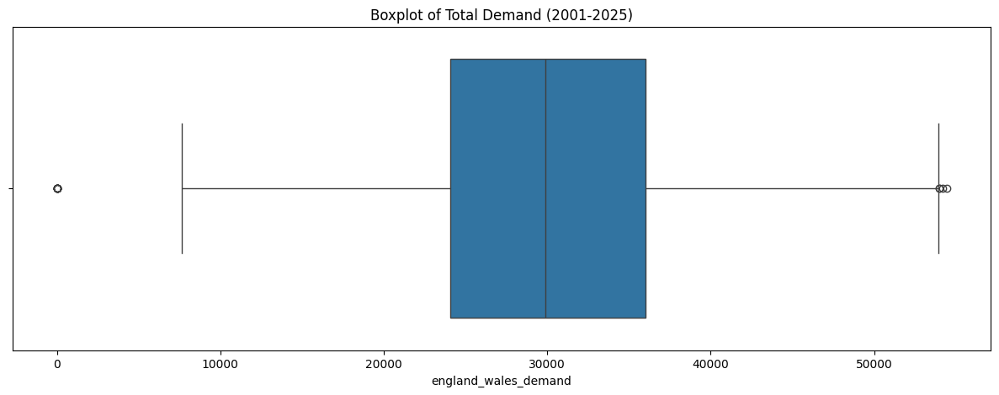

In [6]:
# Visualize
plt.figure(figsize=(15,5))
sns.boxplot(x=energy['england_wales_demand']) # value is in MW
plt.title("Boxplot of Total Demand (2001-2025)")
plt.show()

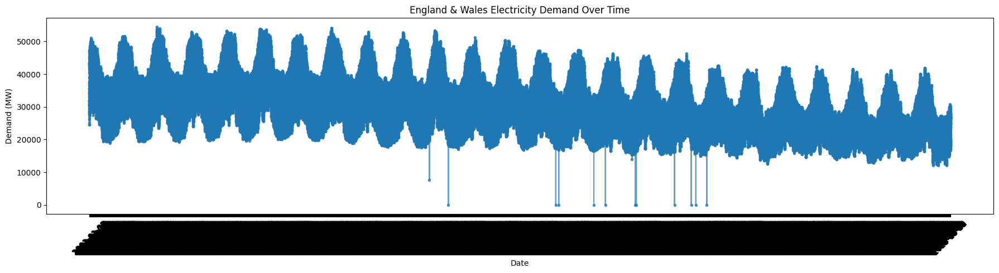

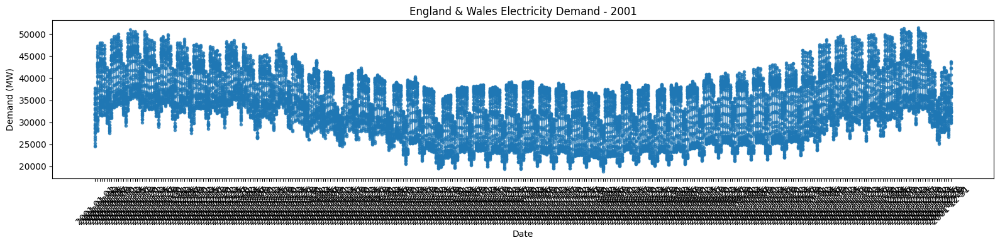

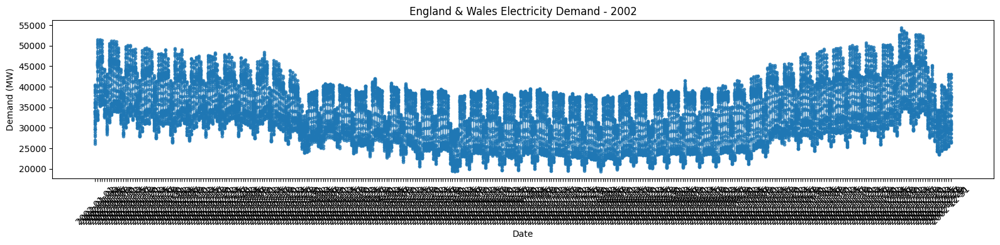

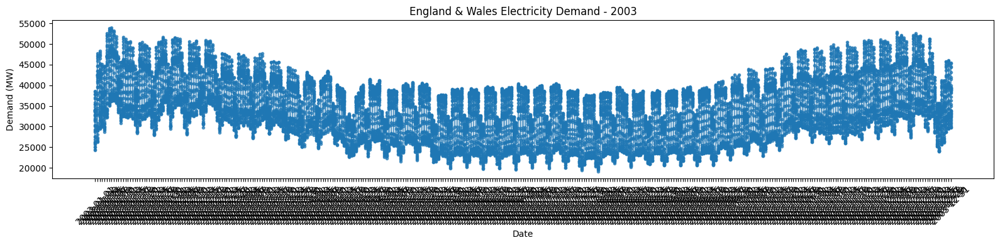

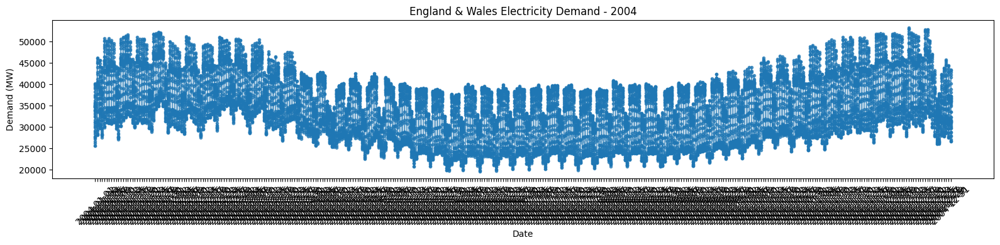

...

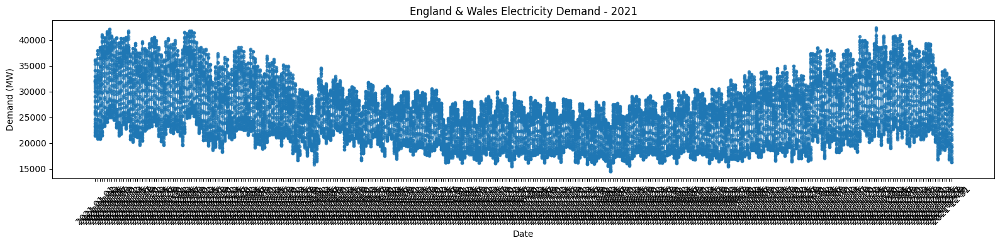

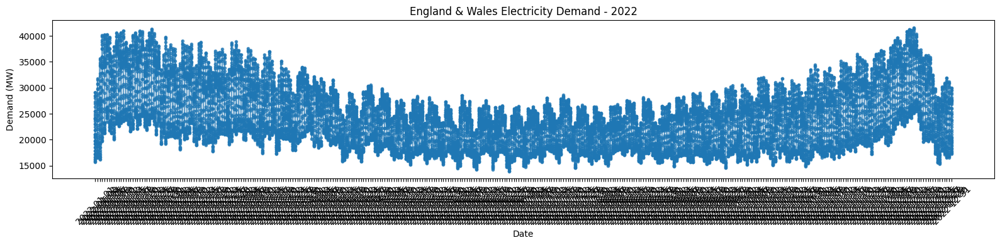

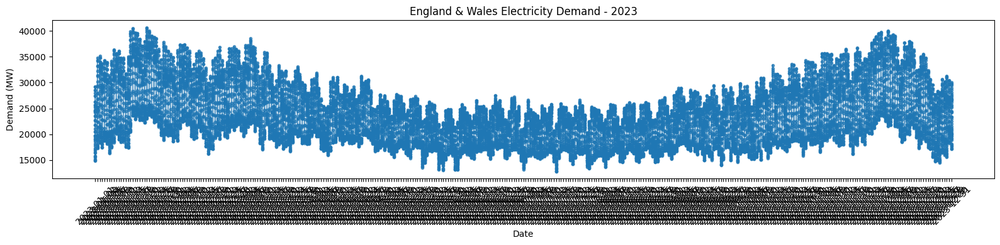

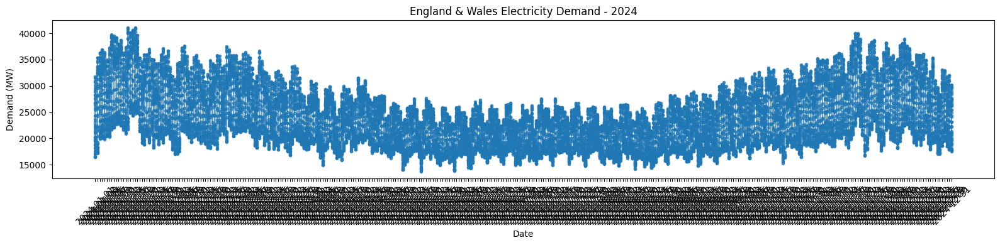

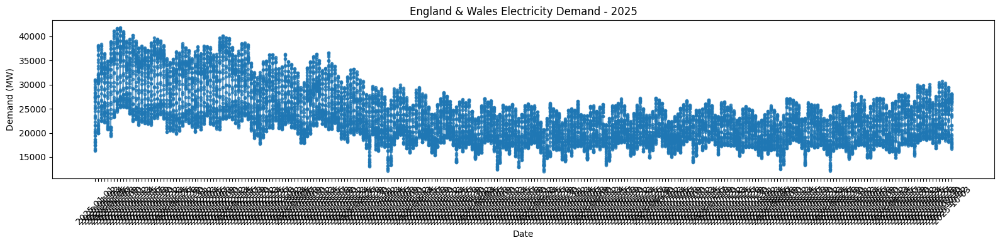

In [7]:
plt.figure(figsize=(18,5))
plt.plot(energy['settlement_date'], energy['england_wales_demand'], marker='.', linestyle='-', alpha=0.7)
plt.title("England & Wales Electricity Demand Over Time")
plt.xlabel("Date")
plt.ylabel("Demand (MW)")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()
# Plot demand per year
energy['year'] = pd.to_datetime(energy['settlement_date']).dt.year
unique_years = sorted(energy['year'].unique())
for yr in unique_years:
    plt.figure(figsize=(16,4))
    subset = energy[energy['year'] == yr]
    plt.plot(subset['settlement_date'], subset['england_wales_demand'], marker='.', linestyle='-', alpha=0.7)
    plt.title(f"England & Wales Electricity Demand - {yr}")
    plt.xlabel("Date")
    plt.ylabel("Demand (MW)")
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

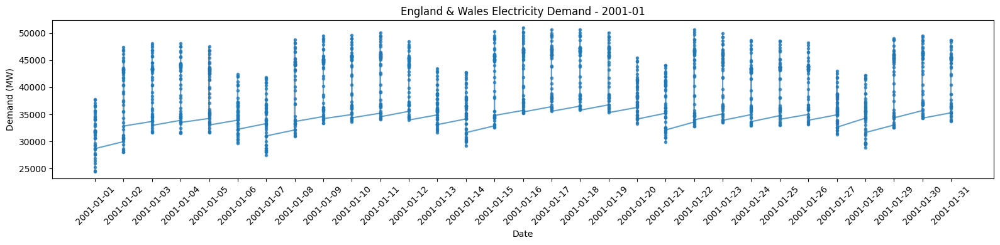

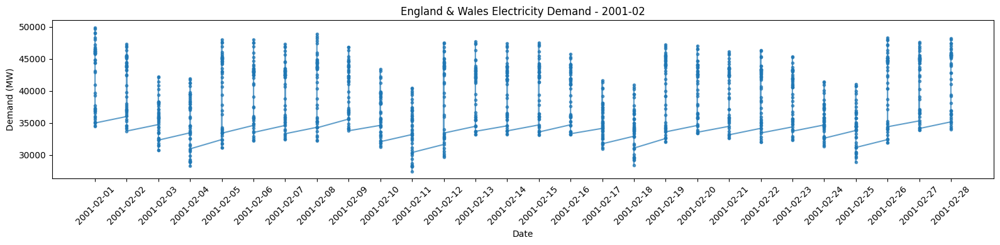

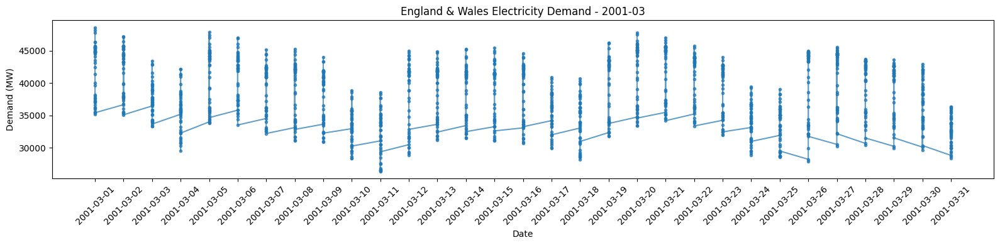

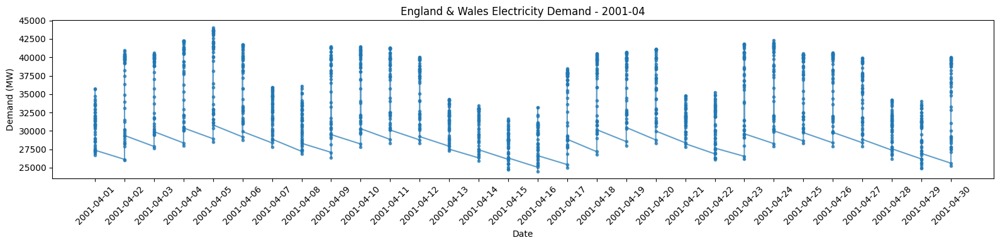

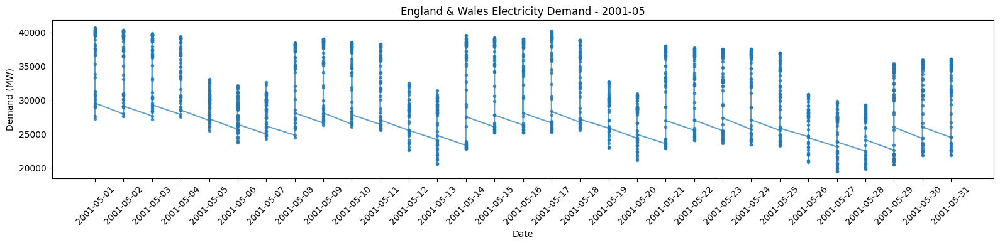

...

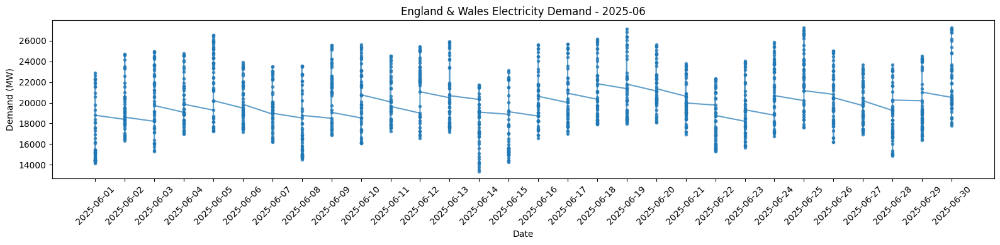

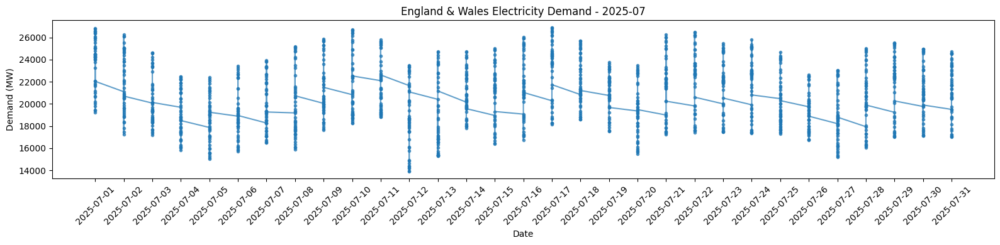

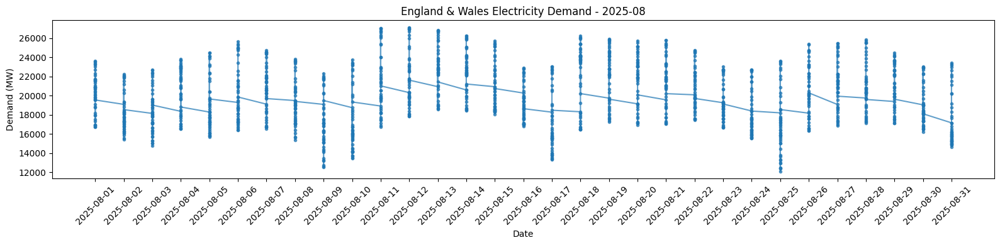

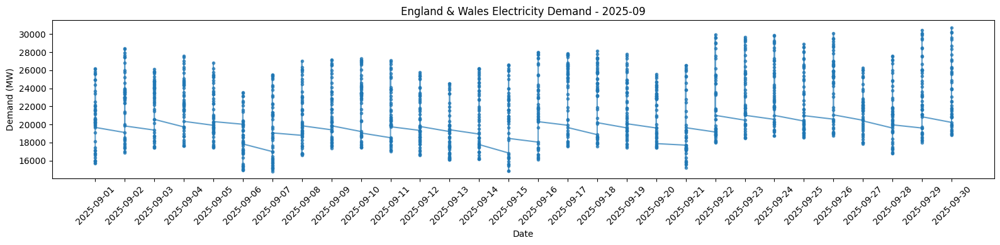

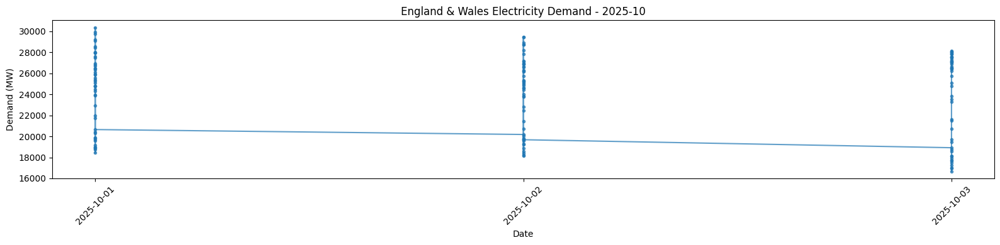

In [8]:
# Plot demand per month
energy['month'] = pd.to_datetime(energy['settlement_date']).dt.to_period('M')
unique_months = sorted(energy['month'].unique())

for m in unique_months:
    plt.figure(figsize=(16,4))
    subset = energy[energy['month'] == m]
    plt.plot(subset['settlement_date'], subset['england_wales_demand'], marker='.', linestyle='-', alpha=0.7)
    plt.title(f"England & Wales Electricity Demand - {m}")
    plt.xlabel("Date")
    plt.ylabel("Demand (MW)")
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# important code

grouped by day instead of every 30-min

In [ ]:
df = energy.copy()

cols_keep = [
    "settlement_date",
    "england_wales_demand",
    "embedded_wind_generation",
    "embedded_solar_generation"
]

df = df[cols_keep].copy()
print(df.head())

  settlement_date  england_wales_demand  embedded_wind_generation  \
0      2001-01-01                 34060                       NaN   
1      2001-01-01                 35370                       NaN   
2      2001-01-01                 35680                       NaN   
3      2001-01-01                 35029                       NaN   
4      2001-01-01                 34047                       NaN   

   embedded_solar_generation  
0                        NaN  
1                        NaN  
2                        NaN  
3                        NaN  
4                        NaN  


In [7]:
df["settlement_date"] = pd.to_datetime(df["settlement_date"])

# If the file has one row per settlement period:
daily = (
    df.groupby("settlement_date", as_index=False)
      .agg({
          "england_wales_demand": "sum",
          "embedded_wind_generation": "sum",
          "embedded_solar_generation": "sum"
      })
)

daily.head()


,settlement_date,england_wales_demand,embedded_wind_generation,embedded_solar_generation
0,2001-01-01,1519976,0.0,0.0
1,2001-01-02,1825356,0.0,0.0
2,2001-01-03,1917902,0.0,0.0
3,2001-01-04,1924663,0.0,0.0
4,2001-01-05,1898027,0.0,0.0


We use linear interpolation for NaNs because the series is continuous in time and adjacent values are strongly related.

In [8]:
daily = daily.sort_values("settlement_date")

daily["england_wales_demand"] = daily["england_wales_demand"].interpolate()
daily["embedded_wind_generation"] = daily["embedded_wind_generation"].interpolate()
daily["embedded_solar_generation"] = daily["embedded_solar_generation"].interpolate()


We cap extreme values at the 1st and 99th percentiles to reduce the influence of rare, very extreme days (e.g. measurement errors or unusual grid events) on our models.

In [9]:
import numpy as np

def cap_outliers(series, lower_q=0.01, upper_q=0.99):
    lower = series.quantile(lower_q)
    upper = series.quantile(upper_q)
    return series.clip(lower, upper)

for col in ["england_wales_demand", "embedded_wind_generation", "embedded_solar_generation"]:
    daily[col] = cap_outliers(daily[col])


In [10]:
clean_path = "electricity_clean_daily.csv"
daily.to_csv(clean_path, index=False)
clean_path


'electricity_clean_daily.csv'

### What can we do with this csv file?

## Idea A — Time series regression: predict demand
Goal: predict tomorrow’s demand based on past demand + wind & solar.

Simple, explaineable model:
Make lag features (e.g. yesterday’s demand, yesterday’s wind/solar).
Train a regression model (RandomForestRegressor / XGBoost / LinearRegression).




In [11]:
df = daily.sort_values("settlement_date").set_index("settlement_date")

for lag in [1, 7]:
    df[f"demand_lag_{lag}"] = df["england_wales_demand"].shift(lag)
    df[f"wind_lag_{lag}"] = df["embedded_wind_generation"].shift(lag)
    df[f"solar_lag_{lag}"] = df["embedded_solar_generation"].shift(lag)

df["day_of_week"] = df.index.dayofweek
df["month"] = df.index.month

df = df.dropna()


In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
import joblib

features = [
    "demand_lag_1", "demand_lag_7",
    "wind_lag_1", "wind_lag_7",
    "solar_lag_1", "solar_lag_7",
    "day_of_week", "month"
]

X = df[features]
y = df["england_wales_demand"]

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, shuffle=False  # time series => no shuffle ideally
)

model = RandomForestRegressor(
    n_estimators=100,
    random_state=42,
    n_jobs=-1
)

model.fit(X_train, y_train)
pred = model.predict(X_test)

# use sklearn.metrics.mean_squared_error to get RMSE
rmse = mean_squared_error(y_test, pred)
print(f"RMSE: {rmse:.2f}")

# model can be saved in the next cell (joblib.dump in cell 25)


RMSE: 3700696725.12


In [19]:
joblib.dump(model, "electricity_rf_baseline.joblib")


['electricity_rf_baseline.joblib']

## Idea B - understanding impact of renewables on demand

Even if you don’t build a complicated model, you can do EDA & simpler regression:
Correlation between england_wales_demand and embedded_wind_generation / embedded_solar_generation.
Scatter plots & regression lines.
Group by month and plot total demand vs total wind / solar.

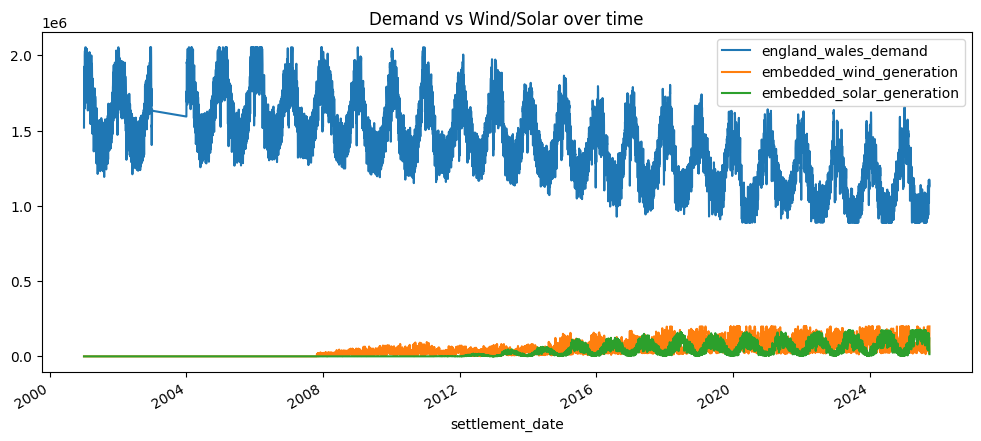

,england_wales_demand,embedded_wind_generation,embedded_solar_generation
england_wales_demand,1.000000,-0.455374,-0.735274
embedded_wind_generation,-0.455374,1.000000,0.380977
embedded_solar_generation,-0.735274,0.380977,1.000000


In [20]:
import matplotlib.pyplot as plt

daily.plot(
    x="settlement_date",
    y=["england_wales_demand", "embedded_wind_generation", "embedded_solar_generation"],
    figsize=(12,5)
)
plt.title("Demand vs Wind/Solar over time")
plt.show()

daily[["england_wales_demand", "embedded_wind_generation", "embedded_solar_generation"]].corr()


We see that wind/solar generally increased over the years; demand does X. Correlations show that …